In [47]:
import mdtraj as md
import os
import sys
import numpy as np
import matplotlib.pyplot as plt
from matplotlib import colors
import math
from numpy import log2, zeros, mean, var, sum, loadtxt, arange, \
                  array, cumsum, dot, transpose, diagonal, floor
from numpy.linalg import inv, lstsq

https://figshare.com/articles/dataset/Microsecond_molecular_dynamics_simulation_of_kinase_domain_of_the_human_tyrosine_kinase_ABL1/4496795/1

This is a one microsecond trajectory of the catalytic domain of the human tyrosine protein kinase ABL1 (UNIPROT:ABL1_HUMAN, residues 242-493). The simulation was generated on Folding@home using OpenMM 6.3.1 with the AMBER99SB-ILDN forcefield, TIP3P water, and neutralizing salt. A Langevin integrator with 2 fs timestep, 300 K temperature, and 1/ps collision rate was used. PME with a nonbonded cutoff of 1.0 nm was used with default tolerance of 5.0e-4. A long-range isotropic dispersion correction was used to correct for the truncation of Lennard-Jones interactions at 1.0 nm. A molecular-scaling Monte Carlo barostat was applied using a 1 atm reference pressure, with MC moves attempted every 50 steps. Coordinates were saved every 250ps, and waters and ions stripped. The trajectory file contains 4000 snapshots. Initial models were generated with Ensembler (see References) using the ABL1 structure from chain B of PDB ID: 2GQG as a template.

https://www.rcsb.org/structure/2GQG

Trajetories and pdb can be downloaded here:
https://www.dropbox.com/s/qymy39ak2apqd75/ABL1.zip?dl=0


In [48]:
pdb="/Users/michellegarcia/git/CHEM101.6_S24/Exercise2/ABL1/ABL1.pdb"
trajectory='/Users/michellegarcia/git/CHEM101.6_S24/Exercise2/ABL1/ABL1.dcd'
outdir='/Users/michellegarcia/git/CHEM101.6_S24/Exercise2/output/'
if not os.path.exists('outdir'):
    os.makedirs('outdir')
    
print("outdir:",outdir)
print("pdb:",pdb)
print("trjaectory:",trajectory)

outdir: /Users/michellegarcia/git/CHEM101.6_S24/Exercise2/output/
pdb: /Users/michellegarcia/git/CHEM101.6_S24/Exercise2/ABL1/ABL1.pdb
trjaectory: /Users/michellegarcia/git/CHEM101.6_S24/Exercise2/ABL1/ABL1.dcd


In [49]:
trj = md.load(trajectory, top=pdb,stride=1)
trj.center_coordinates()
top = trj.topology
first_frame = 0
last_frame = trj.n_frames
n_frames=trj.n_frames

In [50]:
nres=[]
for res in trj.topology.residues: nres.append(res.resSeq)
sequence=(' %s' % [residue for residue in trj.topology.residues])
resname=(' %s' % [residue.name for residue in trj.topology.residues])
resindex=(' %s' % [residue.index for residue in trj.topology.residues])
res_num=(' %s' % [residue.resSeq  for residue in trj.topology.residues])



#log = open("/Users/paulrobustelli/Desktop/Sa_calc.log", "w")
print("** SYSTEM INFO **\n")
print("Number of atoms: %d\n" % trj.n_atoms)
print("Number of residues: %d\n" % len(set(nres)))
print("Number of frames: %d\n" % trj.n_frames)
print("Starting frame: %d\n" % first_frame)
print("Last frame: %d\n" % last_frame)
print("sequence: %s\n" % sequence)
print("residue names: %s\n" % resname)
print("residue number: %s\n" % res_num)
print("residue index: %s\n" % resindex)


** SYSTEM INFO **

Number of atoms: 4062

Number of residues: 252

Number of frames: 4000

Starting frame: 0

Last frame: 4000

sequence:  [ILE242, THR243, MET244, LYS245, HIS246, LYS247, LEU248, GLY249, GLY250, GLY251, GLN252, TYR253, GLY254, GLU255, VAL256, TYR257, GLU258, GLY259, VAL260, TRP261, LYS262, LYS263, TYR264, SER265, LEU266, THR267, VAL268, ALA269, VAL270, LYS271, THR272, LEU273, LYS274, GLU275, ASP276, THR277, MET278, GLU279, VAL280, GLU281, GLU282, PHE283, LEU284, LYS285, GLU286, ALA287, ALA288, VAL289, MET290, LYS291, GLU292, ILE293, LYS294, HIS295, PRO296, ASN297, LEU298, VAL299, GLN300, LEU301, LEU302, GLY303, VAL304, CYS305, THR306, ARG307, GLU308, PRO309, PRO310, PHE311, TYR312, ILE313, ILE314, THR315, GLU316, PHE317, MET318, THR319, TYR320, GLY321, ASN322, LEU323, LEU324, ASP325, TYR326, LEU327, ARG328, GLU329, CYS330, ASN331, ARG332, GLN333, GLU334, VAL335, ASN336, ALA337, VAL338, VAL339, LEU340, LEU341, TYR342, MET343, ALA344, THR345, GLN346, ILE347, SER348, SER3

In [51]:
residue_num=[]
for res in top.residues: 
    residue_num.append(res.resSeq)
residue_id=np.asarray(residue_num)
residue_id

array([242, 243, 244, 245, 246, 247, 248, 249, 250, 251, 252, 253, 254,
       255, 256, 257, 258, 259, 260, 261, 262, 263, 264, 265, 266, 267,
       268, 269, 270, 271, 272, 273, 274, 275, 276, 277, 278, 279, 280,
       281, 282, 283, 284, 285, 286, 287, 288, 289, 290, 291, 292, 293,
       294, 295, 296, 297, 298, 299, 300, 301, 302, 303, 304, 305, 306,
       307, 308, 309, 310, 311, 312, 313, 314, 315, 316, 317, 318, 319,
       320, 321, 322, 323, 324, 325, 326, 327, 328, 329, 330, 331, 332,
       333, 334, 335, 336, 337, 338, 339, 340, 341, 342, 343, 344, 345,
       346, 347, 348, 349, 350, 351, 352, 353, 354, 355, 356, 357, 358,
       359, 360, 361, 362, 363, 364, 365, 366, 367, 368, 369, 370, 371,
       372, 373, 374, 375, 376, 377, 378, 379, 380, 381, 382, 383, 384,
       385, 386, 387, 388, 389, 390, 391, 392, 393, 394, 395, 396, 397,
       398, 399, 400, 401, 402, 403, 404, 405, 406, 407, 408, 409, 410,
       411, 412, 413, 414, 415, 416, 417, 418, 419, 420, 421, 42

In [52]:
#Use DSSP to calculate the secondary structure definition
#https://mdtraj.org/1.9.4/api/generated/mdtraj.compute_dssp.html
dssp=md.compute_dssp(trj,simplified=True)
dssp

array([['C', 'E', 'E', ..., 'C', 'C', 'C'],
       ['C', 'E', 'E', ..., 'H', 'C', 'C'],
       ['C', 'E', 'E', ..., 'C', 'C', 'C'],
       ...,
       ['C', 'E', 'E', ..., 'C', 'C', 'C'],
       ['C', 'E', 'E', ..., 'C', 'C', 'C'],
       ['C', 'E', 'E', ..., 'C', 'C', 'C']], dtype='<U2')

In [53]:
print(dssp.shape)
print("Rows:",len(dssp))
print("Columns:",len(dssp[0]))

#Print out helix and beta residues for a given frame
frame=0
dssp_frame=np.column_stack((residue_id,dssp[frame]))
helix_res=np.where(dssp_frame[:,1]=='H')
beta_res=np.where(dssp_frame[:,1]=='E')
print('helical residues:',dssp_frame[helix_res])
print('beta residues:',dssp_frame[beta_res])

(4000, 252)
Rows: 4000
Columns: 252
helical residues: [['280' 'H']
 ['281' 'H']
 ['282' 'H']
 ['283' 'H']
 ['284' 'H']
 ['285' 'H']
 ['286' 'H']
 ['287' 'H']
 ['288' 'H']
 ['289' 'H']
 ['323' 'H']
 ['324' 'H']
 ['325' 'H']
 ['326' 'H']
 ['327' 'H']
 ['337' 'H']
 ['338' 'H']
 ['339' 'H']
 ['340' 'H']
 ['341' 'H']
 ['342' 'H']
 ['343' 'H']
 ['344' 'H']
 ['345' 'H']
 ['346' 'H']
 ['347' 'H']
 ['348' 'H']
 ['349' 'H']
 ['350' 'H']
 ['351' 'H']
 ['352' 'H']
 ['353' 'H']
 ['354' 'H']
 ['355' 'H']
 ['356' 'H']
 ['357' 'H']
 ['366' 'H']
 ['367' 'H']
 ['368' 'H']
 ['373' 'H']
 ['374' 'H']
 ['375' 'H']
 ['403' 'H']
 ['404' 'H']
 ['405' 'H']
 ['408' 'H']
 ['409' 'H']
 ['410' 'H']
 ['411' 'H']
 ['412' 'H']
 ['413' 'H']
 ['420' 'H']
 ['421' 'H']
 ['422' 'H']
 ['423' 'H']
 ['424' 'H']
 ['425' 'H']
 ['426' 'H']
 ['427' 'H']
 ['428' 'H']
 ['429' 'H']
 ['430' 'H']
 ['431' 'H']
 ['432' 'H']
 ['433' 'H']
 ['449' 'H']
 ['450' 'H']
 ['451' 'H']
 ['452' 'H']
 ['453' 'H']
 ['466' 'H']
 ['467' 'H']
 ['468' 'H

(350.0, 400.0)

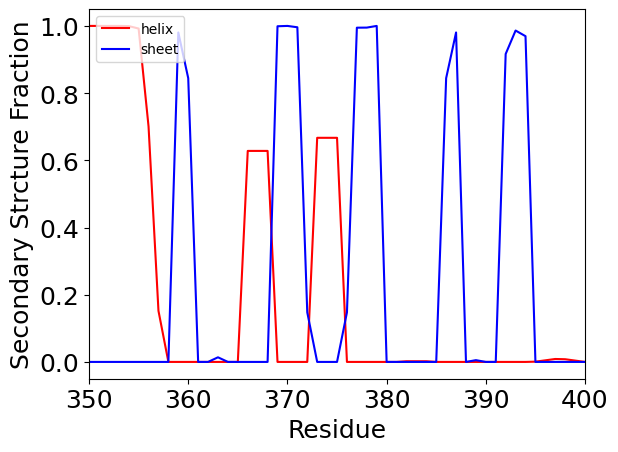

In [54]:
dssp=md.compute_dssp(trj,simplified=True)

def dssp_convert(dssp):
 dsspH=np.copy(dssp)
 dsspE=np.copy(dssp)
 dsspH[dsspH=='H']=1                                                                                      
 dsspH[dsspH=='E']=0                                                                                      
 dsspH[dsspH=='C']=0                                                                                      
 dsspH[dsspH=='NA']=0 
 dsspH=dsspH.astype(int)
 TotalH=np.sum(dsspH,axis=1) 
 Hprop=np.sum(dsspH,axis=0).astype(float)/len(dsspE) 

 dsspE[dsspE=='H']=0
 dsspE[dsspE=='E']=1
 dsspE[dsspE=='C']=0
 dsspE[dsspE=='NA']=0
 dsspE=dsspE.astype(int)
 TotalE=np.sum(dsspE,axis=1) 
 Eprop=np.sum(dsspE,axis=0).astype(float)/len(dsspE) 
 return Hprop, Eprop

Hprop,Eprop=dssp_convert(dssp)
plt.plot(residue_num,Hprop,c='r',label='helix')
plt.plot(residue_num,Eprop,c='b',label='sheet')

plt.legend(loc="upper left")
plt.xlabel('Residue', size=18)
plt.ylabel('Secondary Strcture Fraction', size=18)
plt.tick_params(labelsize=18)
plt.xlim(350,400)


***HOMEWORK Problem 1***

**Use the full DSSP set of secondary structure assignments to plot the population of another secondary structure type and visualize it with a representative frame or frames in VMD**

**Consult the original DSSP paper (or online documentaiton) to confirm the criteria for this assignment** 

Kabsch W, Sander C (1983). “Dictionary of protein secondary structure: pattern recognition of hydrogen-bonded and geometrical features”. Biopolymers 22 (12): 2577-637. doi:10.1002/bip.360221211

dssp=md.compute_dssp(trj,simplified=False)

https://mdtraj.org/1.9.4/api/generated/mdtraj.compute_dssp.html

The DSSP assignment codes are:

‘H’ : Alpha helix

‘B’ : Residue in isolated beta-bridge

‘E’ : Extended strand, participates in beta ladder

‘G’ : 3-helix (3/10 helix)

‘I’ : 5 helix (pi helix)

‘T’ : hydrogen bonded turn

‘S’ : bend

‘ ‘ : Loops and irregular elements

The simplified DSSP codes are:

‘H’ : Helix. Either of the ‘H’, ‘G’, or ‘I’ codes.

‘E’ : Strand. Either of the ‘E’, or ‘B’ codes.

‘C’ : Coil. Either of the ‘T’, ‘S’ or ‘ ‘ codes.

In [55]:
####HOMEWORK ######
#Use the full DSSP Definition and plot the population of another secondary structure type 
#https://mdtraj.org/1.9.4/api/generated/mdtraj.compute_dssp.html

dssp_full=md.compute_dssp(trj,simplified=False)


In [56]:
def dssp_convert_full(dssp_full, Assignment): 
    
    dssp = np.copy(dssp_full)
    dssp[dssp!=Assignment]=0
    dssp[dssp==Assignment]=1
    dssp = dssp.astype(int)

    return np.mean(dssp ,axis=0)

([<matplotlib.axis.XTick at 0x12fdb4e20>,
 [Text(242, 0, '242'),
  Text(252, 0, '252'),
  Text(262, 0, '262'),
  Text(272, 0, '272'),
  Text(282, 0, '282'),
  Text(292, 0, '292'),
  Text(302, 0, '302'),
  Text(312, 0, '312'),
  Text(322, 0, '322'),
  Text(332, 0, '332'),
  Text(342, 0, '342'),
  Text(352, 0, '352'),
  Text(362, 0, '362'),
  Text(372, 0, '372'),
  Text(382, 0, '382'),
  Text(392, 0, '392'),
  Text(402, 0, '402'),
  Text(412, 0, '412'),
  Text(422, 0, '422'),
  Text(432, 0, '432'),
  Text(442, 0, '442'),
  Text(452, 0, '452'),
  Text(462, 0, '462'),
  Text(472, 0, '472'),
  Text(482, 0, '482'),
  Text(492, 0, '492')])

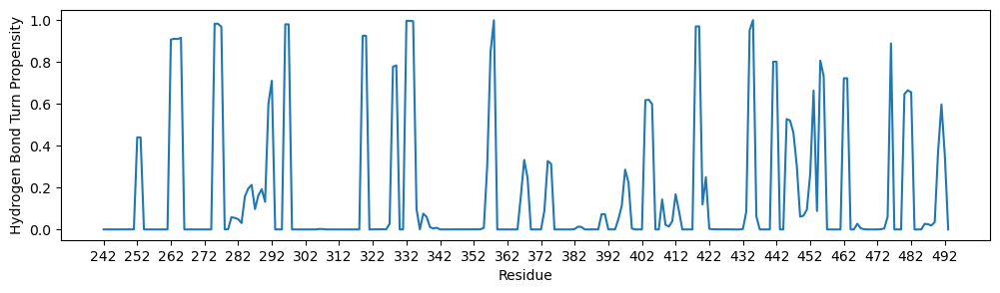

In [57]:
plt.figure(figsize=(12, 3))
plt.plot(residue_num, dssp_convert_full(dssp_full=dssp_full, Assignment="T"))
plt.ylabel("Hydrogen Bond Turn Propensity")
plt.xlabel("Residue")
plt.xticks(np.arange(residue_num[0],residue_num[-1],10))

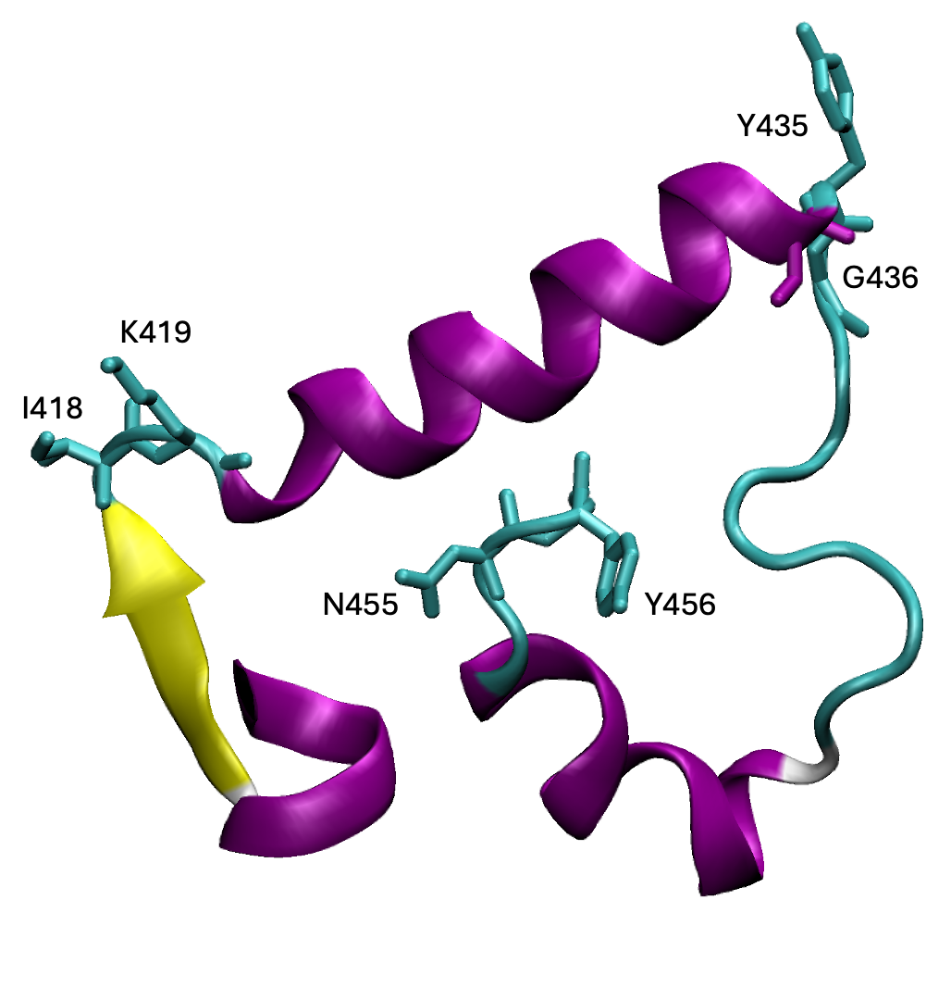

***Challenge Problem #1***

**Write function/efficient loop to calculate all secondary structure populations from the dssp_full definitions 
and write out all residues numbers with > 90% of each seondary structure type**

In [58]:
#### Challenge Problem Write a Function to Compute the Population of Any Secondary Structure Type
#### Write a loop to plot all populations
#### Write code to output the residue numbers of every residue with > 90% each SS type


### code given in class ###



***HOMEWORK Problem 2***

**Identify a residue that has a substantial population (>10%) of a second secondary structure assignment 
(for example something that is 50% helix/ 50% coil or 80% helix/ 20% coil) and make representative snapshots to illustrate the 2 conformations.  Can you identify any other structural changes in the vicinity of that residue that favor the 2nd conformation**

In [59]:
#Find all the frames where a given residue is H or E
residue_number=340
array_index=residue_number- 242 # subtracting 242 because starting number
print(np.asarray(residue_num)[array_index])
helix_frames=np.where(dssp[:,array_index]=='H')
beta_frames=np.where(dssp[:,array_index]=='E')

print("Residue %s"%np.asarray(residue_num)[array_index])
print("helix_frames:", helix_frames)
print("beta_frames:", beta_frames)

340
Residue 340
helix_frames: (array([   0,    1,    2, ..., 3997, 3998, 3999]),)
beta_frames: (array([], dtype=int64),)


In [60]:
# residues with helix and without

# what residues have a Hprop that I care about? 
resid_index_H_half = np.where((Hprop>0.5) & (Hprop <0.7))[0]
resid_index_H_half
np.array(residue_num)[resid_index_H_half]

array([366, 367, 368, 373, 374, 375, 448, 490])

In [61]:
# residues with sheet and without

# what residues have a Hprop that I care about? 
resid_index_S_half = np.where((Eprop>0.8) & (Eprop <0.9))[0]
resid_index_S_half
np.array(residue_num)[resid_index_S_half]

array([244, 245, 250, 254, 360, 386])

<BarContainer object of 3 artists>

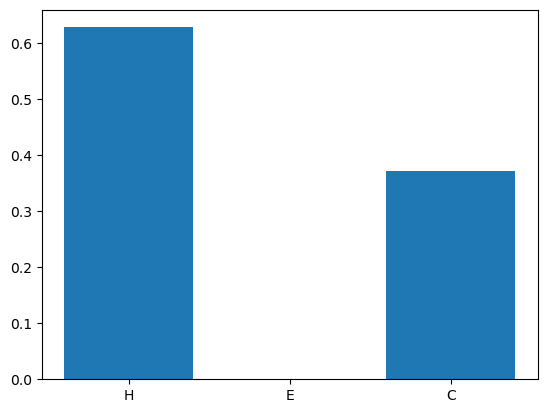

In [62]:
# okay let's go with 366 to 368 
# what are the frames where this is helix? 
residue_number = 366
residue_366_dssp = dssp[:,residue_number- 242]
frames_H = np.where(residue_366_dssp == "H")[0]
frames_E = np.where(residue_366_dssp == "E")[0]
frames_C = np.where(residue_366_dssp == "C")[0]
# what are the frames where it is not? 

plt.bar(x=["H", "E", "C"], height=[len(frames_H)/4000, len(frames_E)/4000, len(frames_C)/4000])

<BarContainer object of 3 artists>

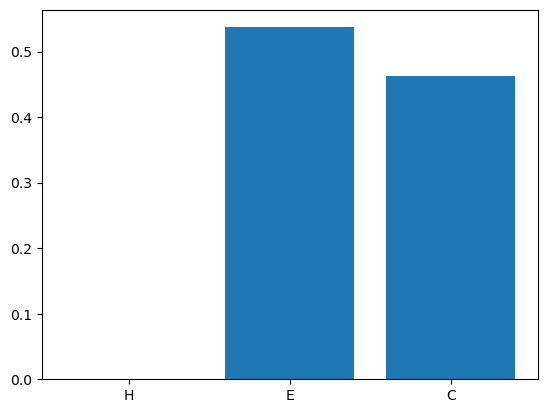

In [63]:

# what are the frames where this is sheet? 
residue_244_dssp = dssp[:,1]
frames_H = np.where(residue_244_dssp == "H")[0]
frames_E = np.where(residue_244_dssp == "E")[0]
frames_C = np.where(residue_244_dssp == "C")[0]
# what are the frames where it is not? 

plt.bar(x=["H", "E", "C"], height=[len(frames_H)/4000, len(frames_E)/4000, len(frames_C)/4000])

In [64]:
frames_E

array([   0,    1,    2, ..., 3997, 3998, 3999])

In [65]:
frames_C

array([   4,    5,    6, ..., 3989, 3990, 3991])

In [66]:
print(frames_E[0], frames_C[0])

0 4


In [67]:
frames_C

array([   4,    5,    6, ..., 3989, 3990, 3991])

I can see the difference in assignment from sheet to coil, which may be correlated with a diferent rotamer for THR243. 

In [68]:
indices_phi, phis = md.compute_phi(trj)
indices_psi, psis = md.compute_psi(trj)
indices_chi1, chi1s = md.compute_chi1(trj)
indices_chi2, chi2s = md.compute_chi2(trj)

In [69]:
np.shape(phis[:,0])

(4000,)

In [70]:
phi_dict={}
dihedral_dict = { 'phi': { },
          'psi': { },
          'chi1': { },
          'chi2': { }}

for i in range(0,len(indices_phi)):
  indices=indices_phi[i]
  atom=top.atom(indices[1])
  resnum=top.atom(indices[1]).residue.resSeq
  dihedral_dict['phi'][resnum]=phis[:,i]

for i in range(0,len(indices_psi)):
  indices=indices_psi[i]
  atom=top.atom(indices[1])
  resnum=top.atom(indices[1]).residue.resSeq
  dihedral_dict['psi'][resnum]=psis[:,i]

for i in range(0,len(indices_chi1)):
  indices=indices_chi1[i]
  atom=top.atom(indices[1])
  resnum=top.atom(indices[1]).residue.resSeq
  dihedral_dict['chi1'][resnum]=chi1s[:,i]

for i in range(0,len(indices_chi2)):
  indices=indices_chi2[i]
  atom=top.atom(indices[1])
  resnum=top.atom(indices[1]).residue.resSeq
  dihedral_dict['chi2'][resnum]=chi2s[:,i]

In [71]:
sequence

' [ILE242, THR243, MET244, LYS245, HIS246, LYS247, LEU248, GLY249, GLY250, GLY251, GLN252, TYR253, GLY254, GLU255, VAL256, TYR257, GLU258, GLY259, VAL260, TRP261, LYS262, LYS263, TYR264, SER265, LEU266, THR267, VAL268, ALA269, VAL270, LYS271, THR272, LEU273, LYS274, GLU275, ASP276, THR277, MET278, GLU279, VAL280, GLU281, GLU282, PHE283, LEU284, LYS285, GLU286, ALA287, ALA288, VAL289, MET290, LYS291, GLU292, ILE293, LYS294, HIS295, PRO296, ASN297, LEU298, VAL299, GLN300, LEU301, LEU302, GLY303, VAL304, CYS305, THR306, ARG307, GLU308, PRO309, PRO310, PHE311, TYR312, ILE313, ILE314, THR315, GLU316, PHE317, MET318, THR319, TYR320, GLY321, ASN322, LEU323, LEU324, ASP325, TYR326, LEU327, ARG328, GLU329, CYS330, ASN331, ARG332, GLN333, GLU334, VAL335, ASN336, ALA337, VAL338, VAL339, LEU340, LEU341, TYR342, MET343, ALA344, THR345, GLN346, ILE347, SER348, SER349, ALA350, MET351, GLU352, TYR353, LEU354, GLU355, LYS356, LYS357, ASN358, PHE359, ILE360, HIS361, ARG362, ASP363, LEU364, ALA365, ALA36

In [72]:
#Heres a function to plot a phi/psi ramachandran plot:

def plot_phipsi(res):
 plt.hist2d(dihedral_dict['phi'][res],dihedral_dict['psi'][res],bins=36,range=[[-3.14,3.14],[-3.14,3.14]], norm=colors.LogNorm(),cmap='jet')
 plt.xlabel('$\phi$', size=18)
 plt.ylabel('$\psi$', size=18)
 plt.xticks([-3.14,-3.14/2,0,3.14/2,3.14],fontsize=35)
 plt.yticks([-3.14,-3.14/2,0,3.14/2,3.14],fontsize=35)
 plt.tick_params(labelsize=18)
 plt.show()
 return

def plot_chi(res):
    if res in dihedral_dict['chi1']:
     plt.hist(dihedral_dict['chi1'][res],bins=36,range=[-3.14,3.14])        
     plt.xticks([-3.14,-3.14/2,0,3.14/2,3.14],fontsize=35)
     plt.xlabel('$\chi_1$', size=18)
     plt.ylabel('counts', size=18)
     plt.tick_params(labelsize=18)
     plt.show()
     plt.clf()   
    if res in dihedral_dict['chi2']:
     plt.hist2d(dihedral_dict['chi1'][res],dihedral_dict['chi2'][res],bins=36,range=[[-3.14,3.14],[-3.14,3.14]], norm=colors.LogNorm(),cmap='jet')
     plt.xlabel('$\chi_1$', size=18)
     plt.ylabel('$\chi_2$', size=18)
     plt.xticks([-3.14,-3.14/2,0,3.14/2,3.14],fontsize=35)
     plt.yticks([-3.14,-3.14/2,0,3.14/2,3.14],fontsize=35)
     plt.tick_params(labelsize=18)
     plt.show()
    return




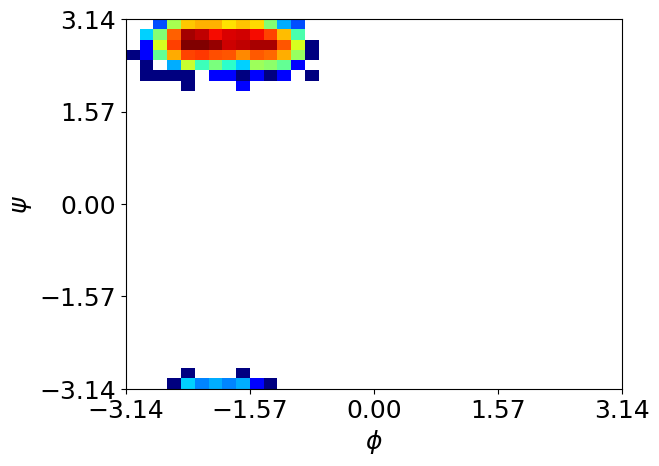

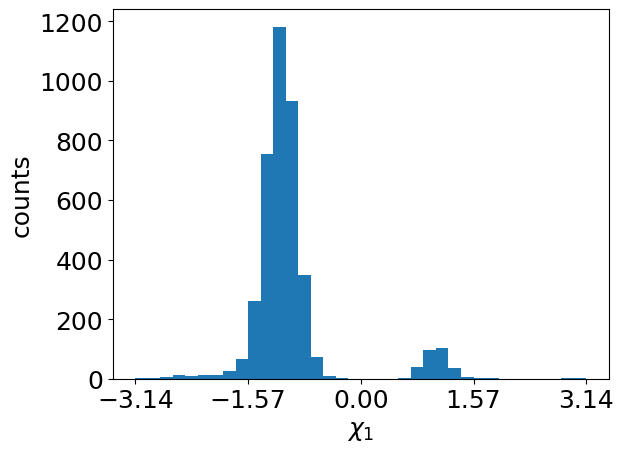

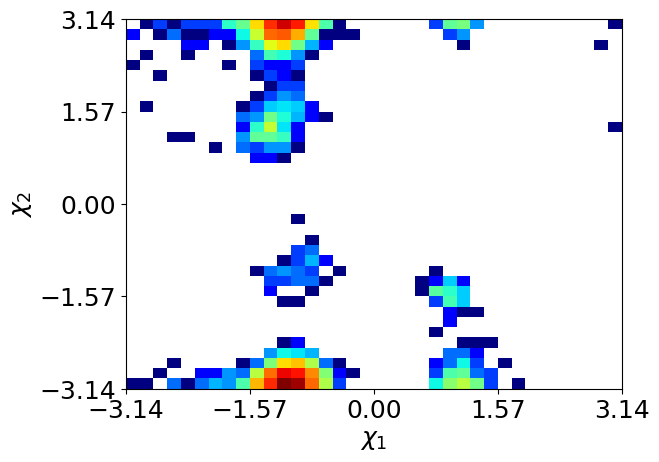

In [73]:
plot_phipsi(308)
plt.clf()
plot_chi(308)

In [74]:
#Lets Visualize Some Rotamers
#Lets Find all the VAL residues and plot thier X1 values
CA_sel=top.select('name CA')
resnames=[]
resnums=[]
for i in CA_sel:
 resnum=top.atom(i).residue.resSeq
 resnums.append(resnum)
 resname=top.atom(i).residue.name
 resnames.append(resname)

resnums=np.asarray(resnums)
resnames=np.asarray(resnames)
VAL_indices=np.where(resnames=='VAL')
Val_resnums=resnums[VAL_indices]
Val_resnums

array([256, 260, 268, 270, 280, 289, 299, 304, 335, 338, 339, 371, 377,
       379, 422, 427, 448, 468])

Residue 256


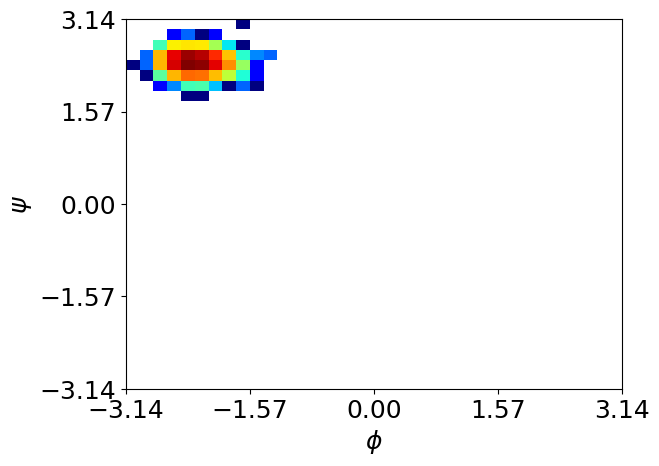

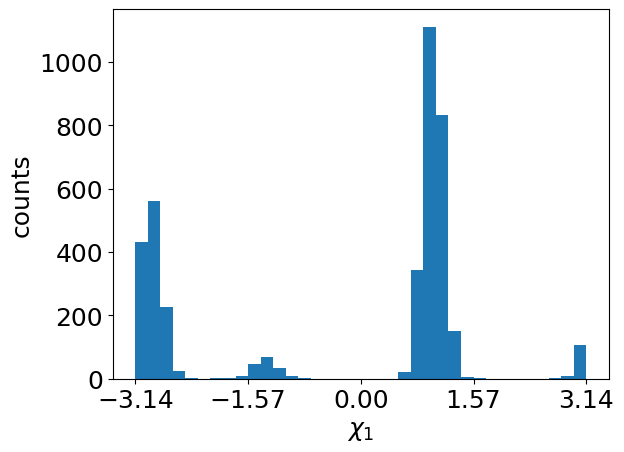

Residue 260


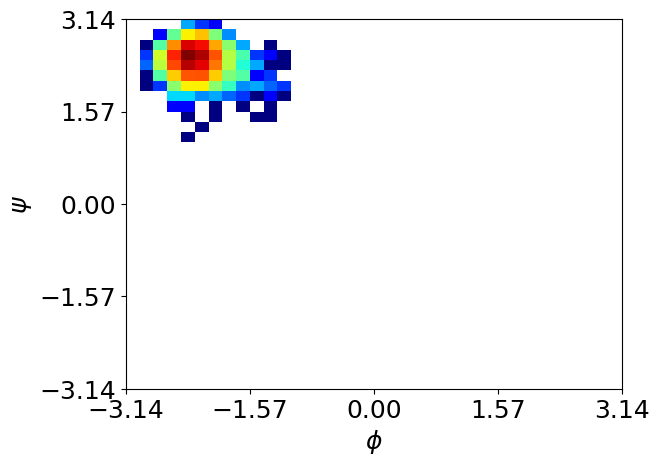

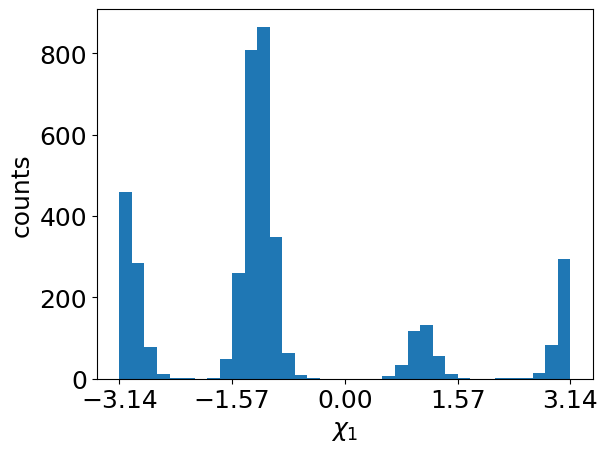

Residue 268


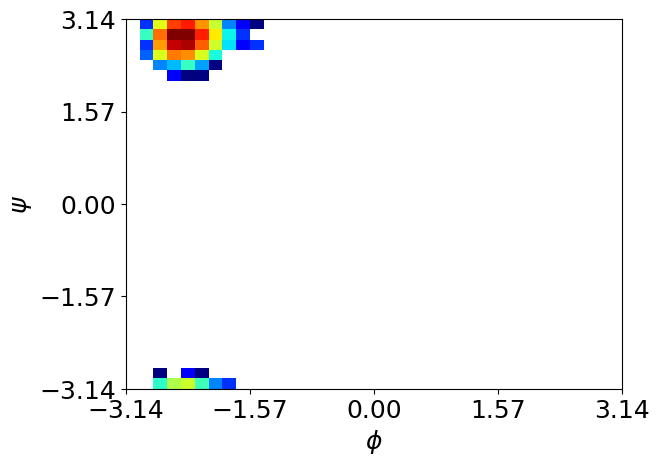

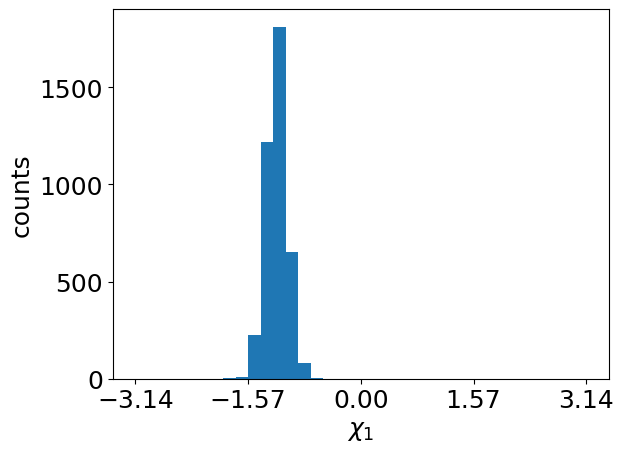

Residue 270


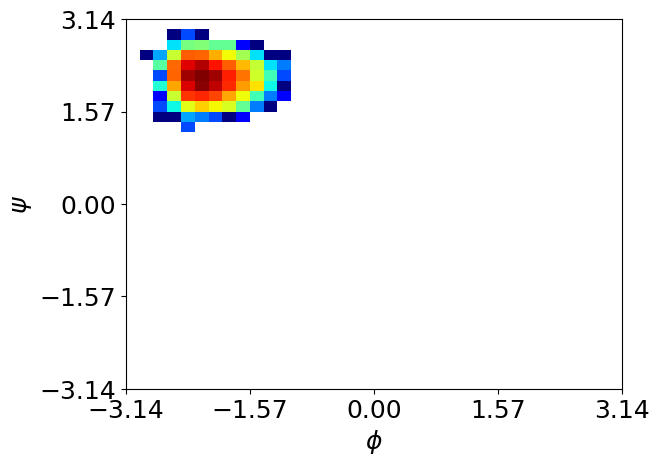

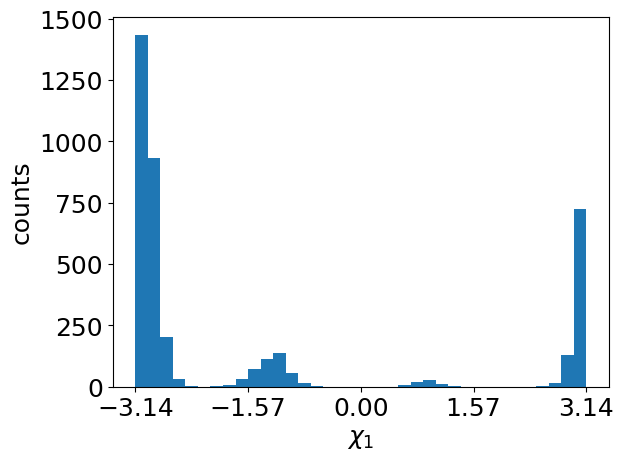

Residue 280


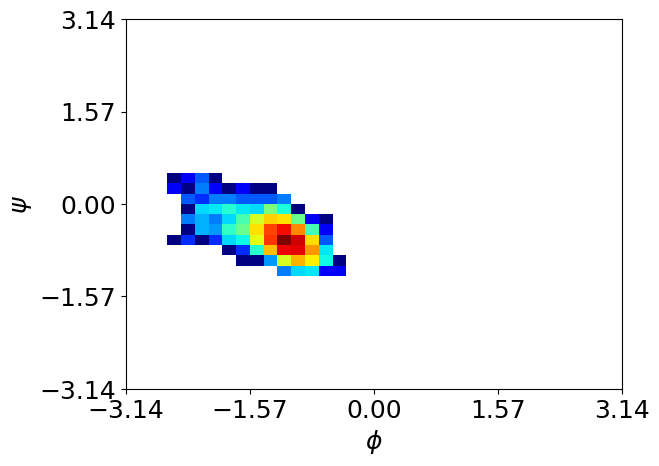

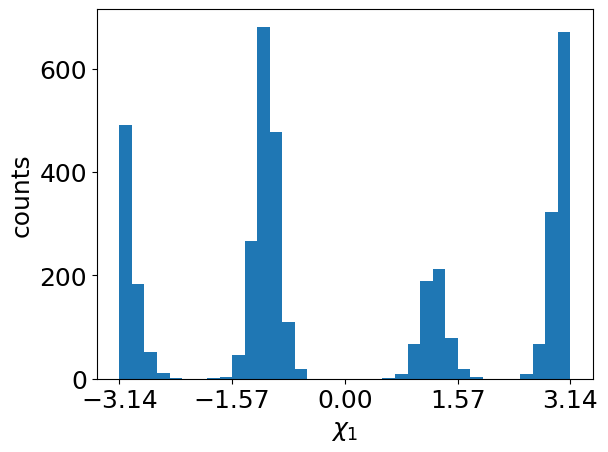

Residue 289


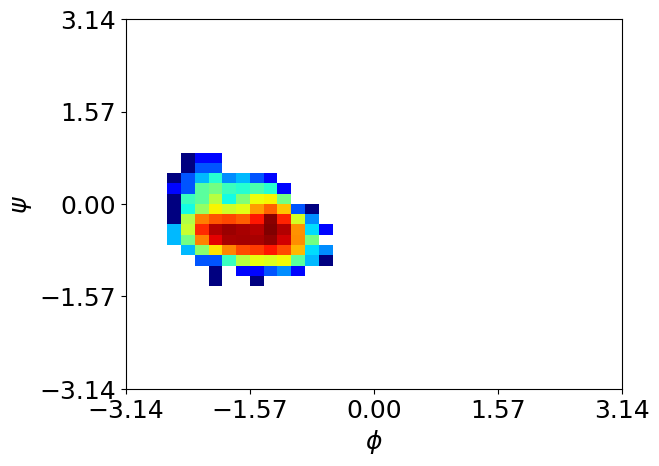

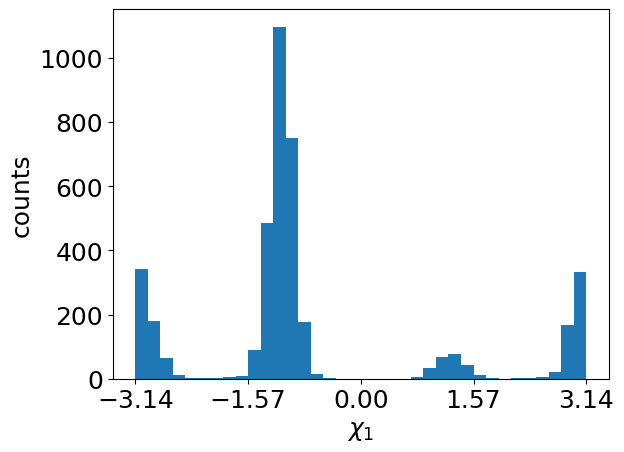

Residue 299


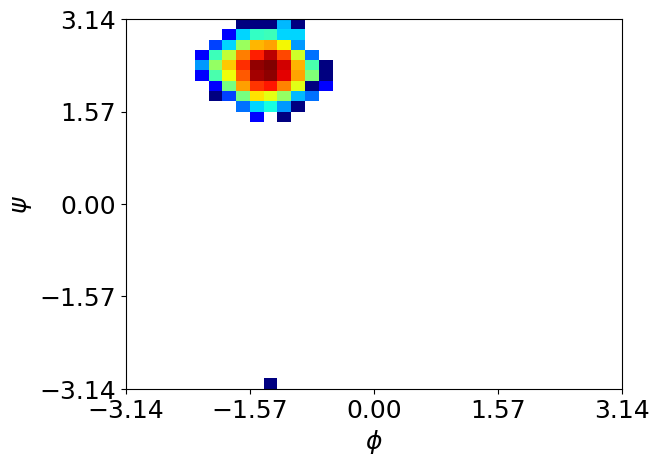

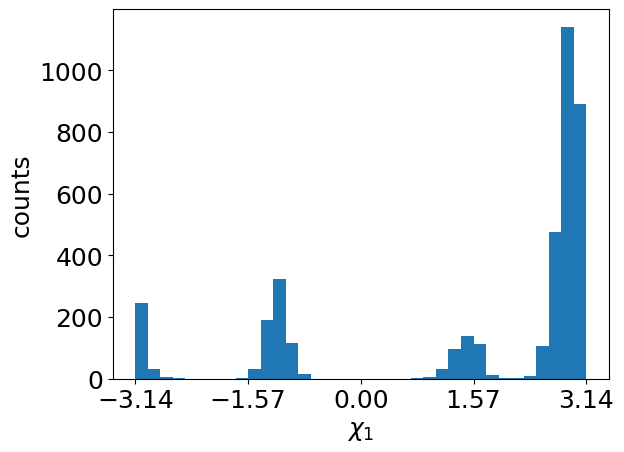

Residue 304


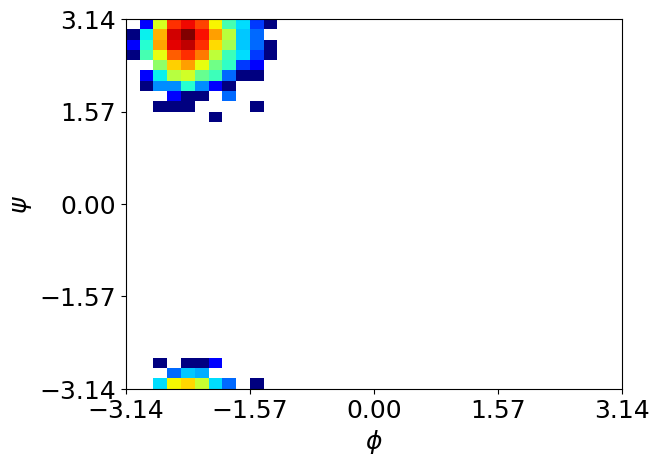

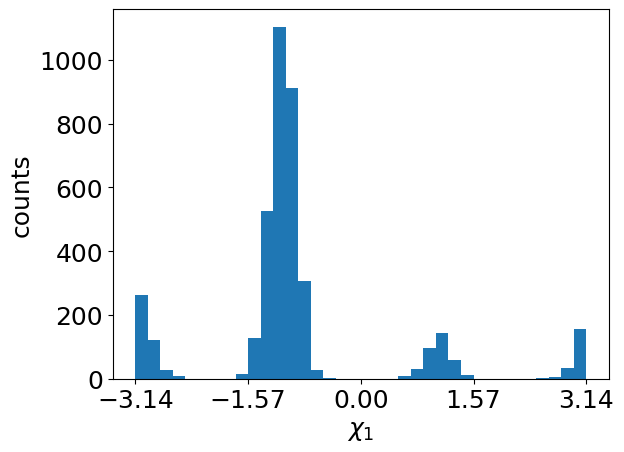

Residue 335


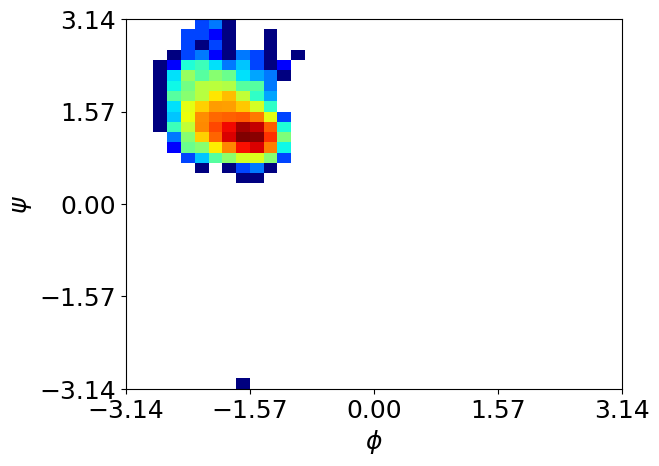

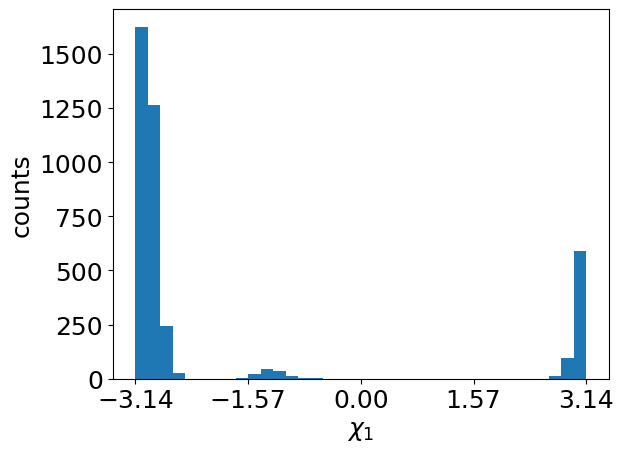

Residue 338


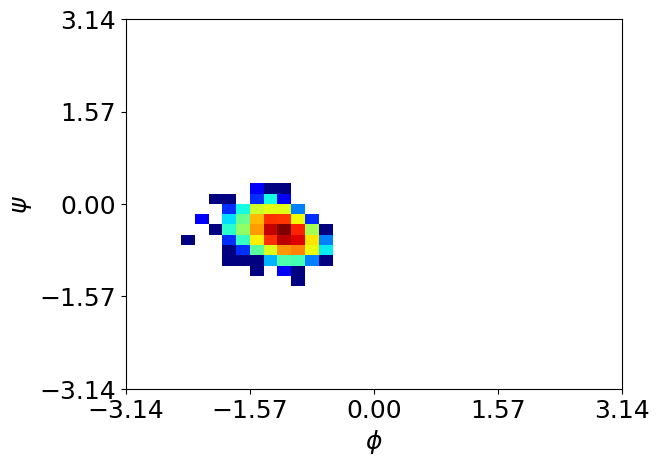

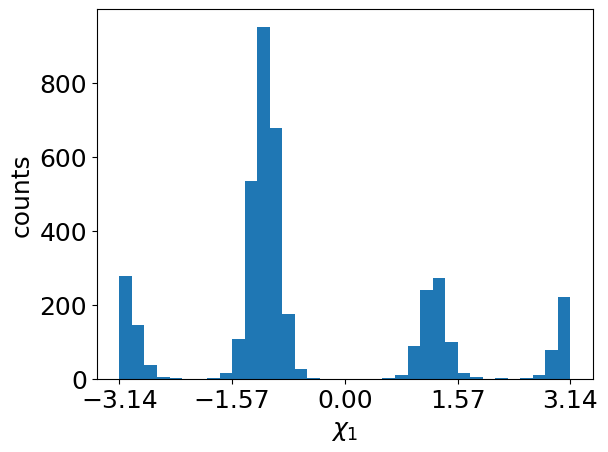

Residue 339


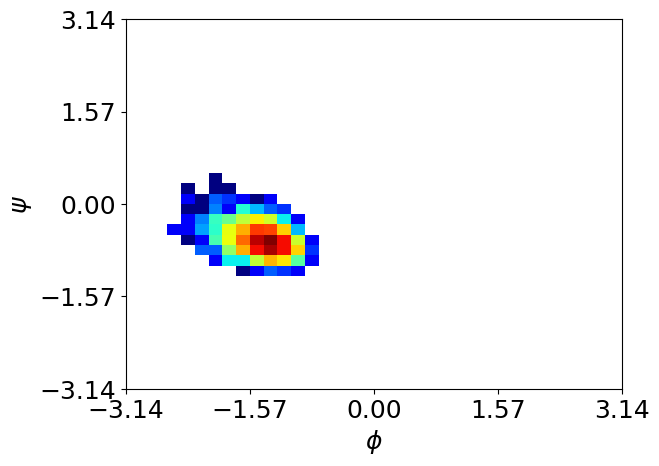

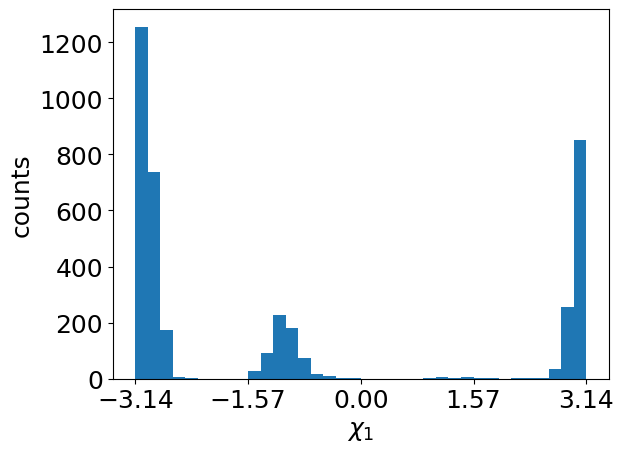

Residue 371


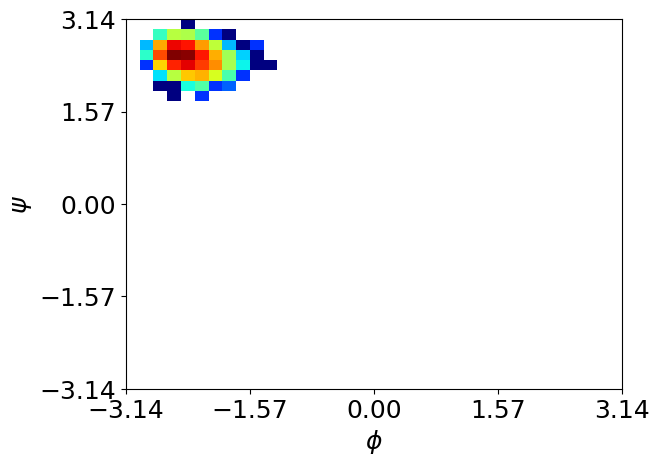

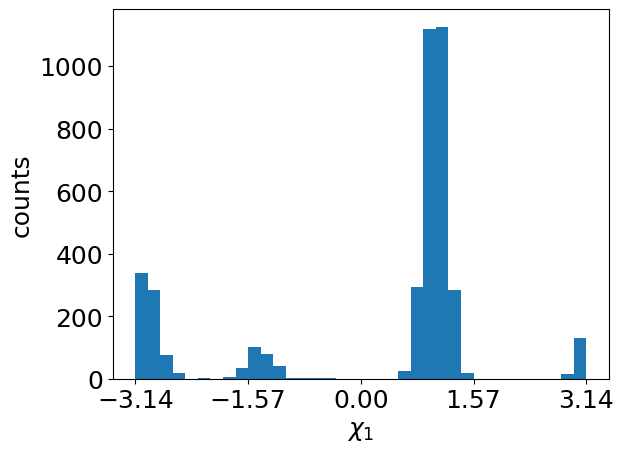

Residue 377


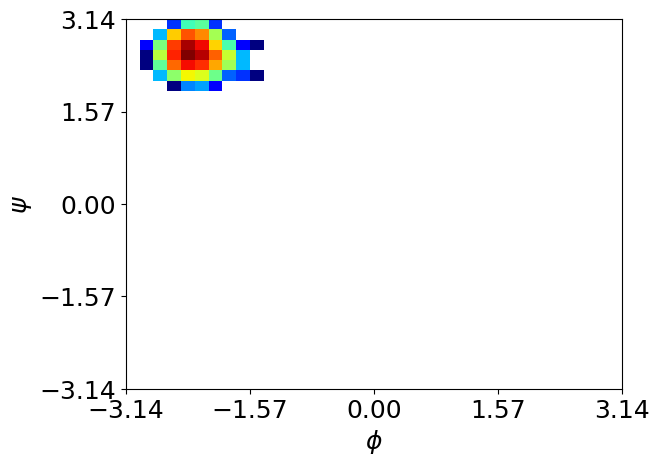

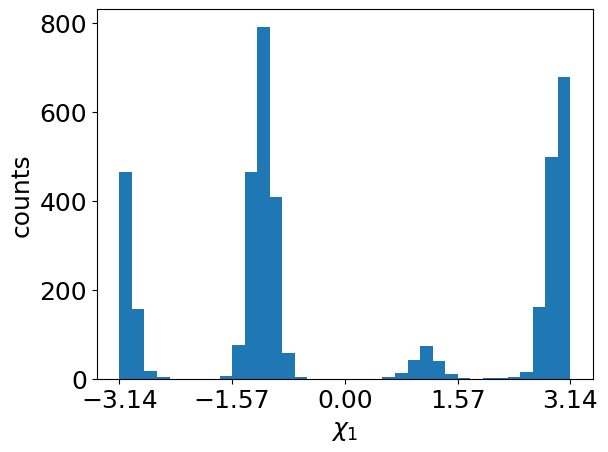

Residue 379


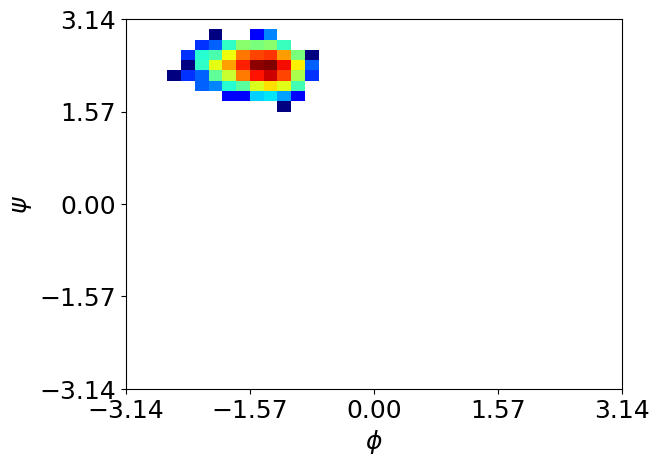

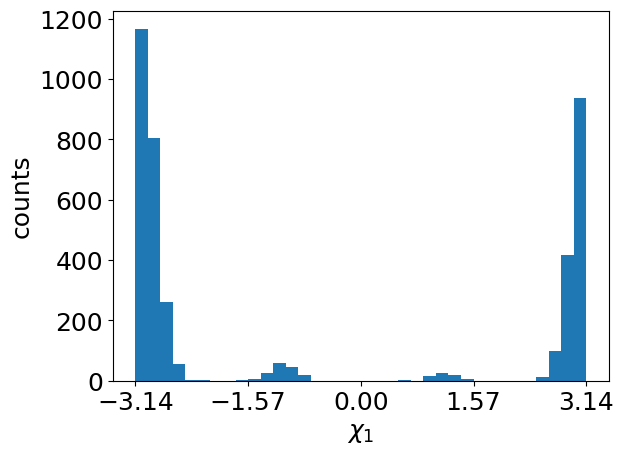

Residue 422


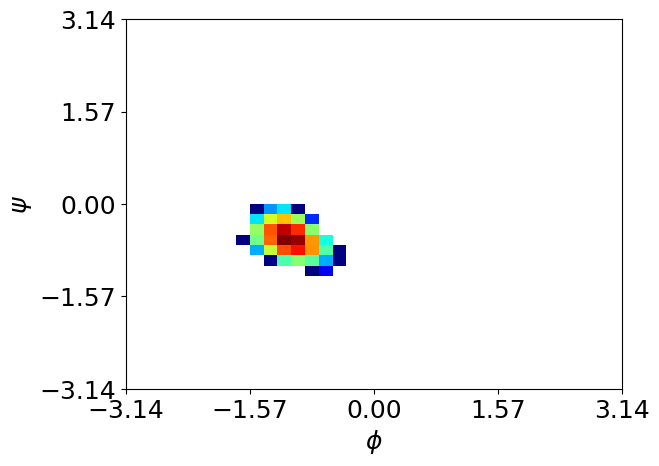

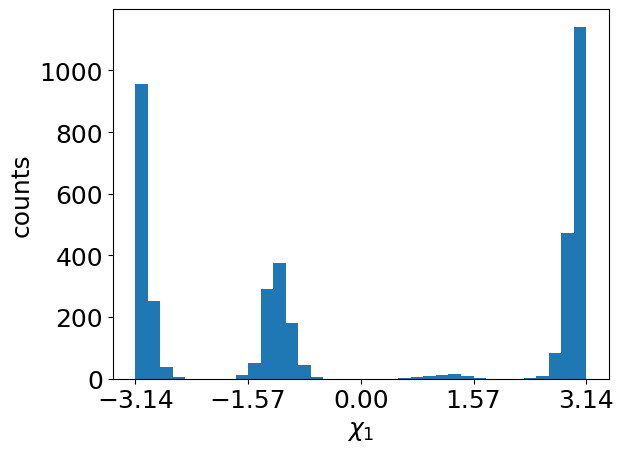

Residue 427


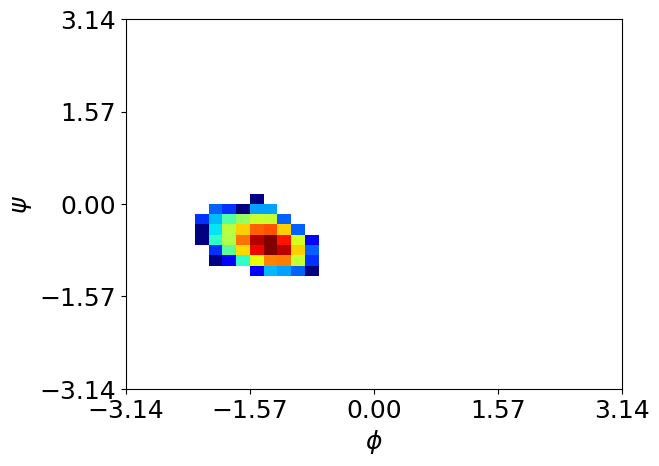

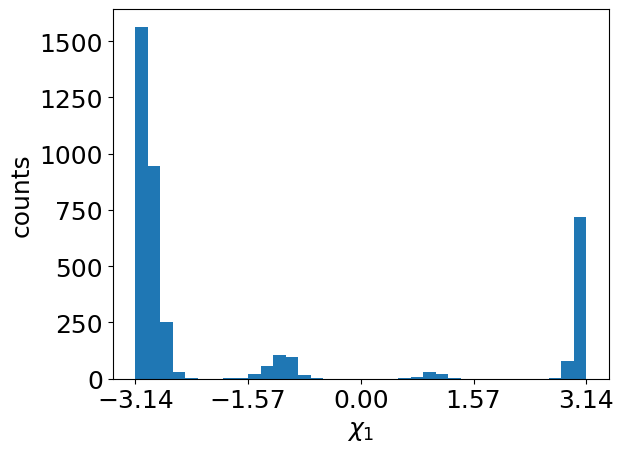

Residue 448


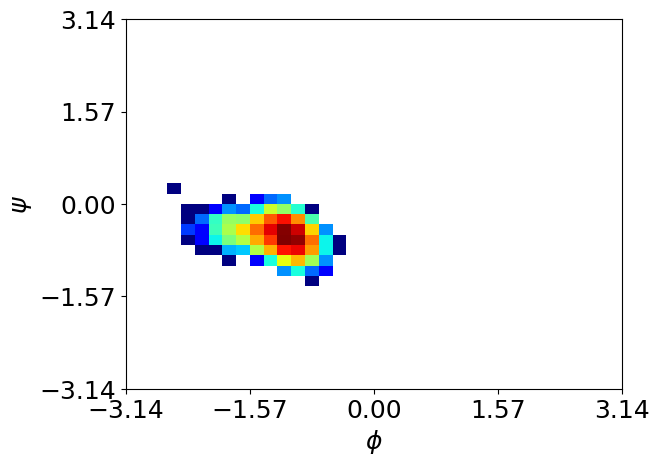

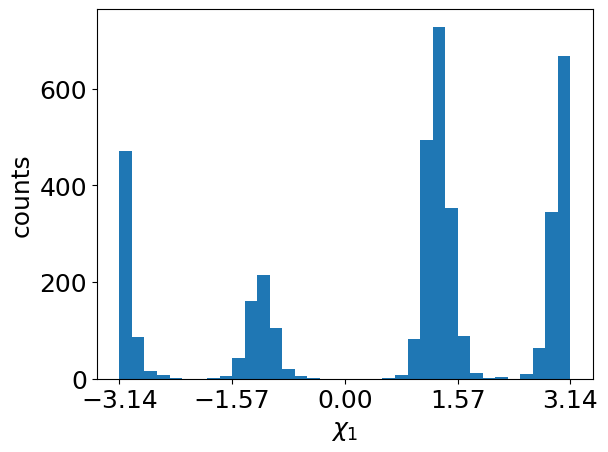

Residue 468


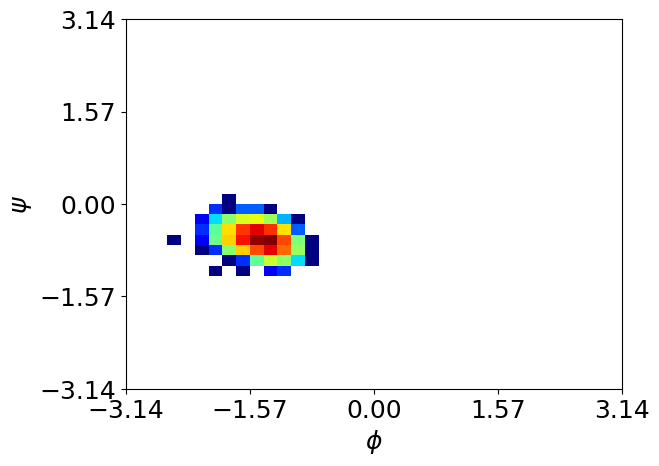

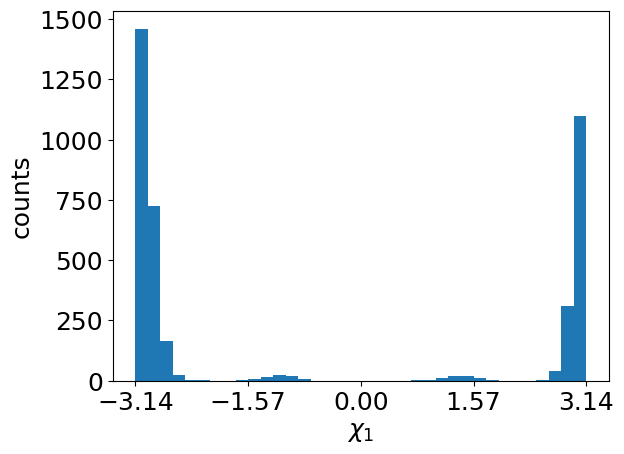

<Figure size 640x480 with 0 Axes>

In [75]:
for i in Val_resnums:
    print("Residue",i)
    plot_phipsi(i)
    plt.clf()
    plot_chi(i)
    plt.clf()

***HOMEWORK Problem 3***

**Identify a residue that has 2 rotameric states and make representative snapshots to illustrate the 2 conformations (or a single snapshot with an overlay of two representative conformations).  Can you identify any other structural changes in the vicinity of that residue that favor the 2nd conformation.  Make a plot of the Chi 1 histogram (or Chi1/Chi2 if the residue has a Chi2 degree of freedom) and add a marking to the plot to indicate the dihedrals shown in your snapshot**



The residue that I identify with two rotameric states is Y253. In the following image, there is one frame (turqoise) that is in the alpha-helix, and another frame that is in beta-sheet. Yes, the structural changes that we see is in the beta-sheet conformation Y253 is right at the tip of the hairpin, whereas in the alpha-helix assignment, it is actually present on a beta-strand, but the phi and psi angles give it a helix assignment. 

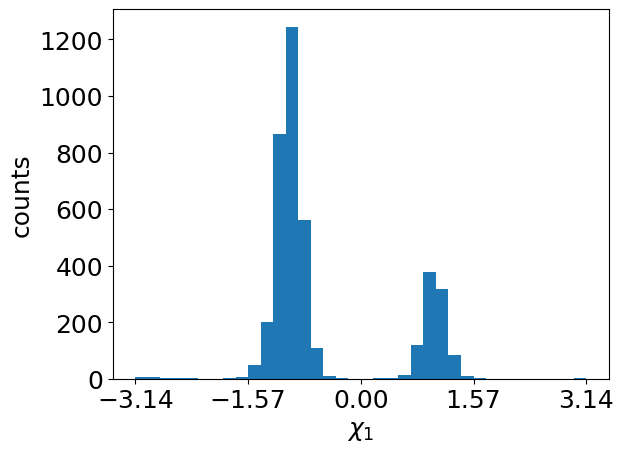

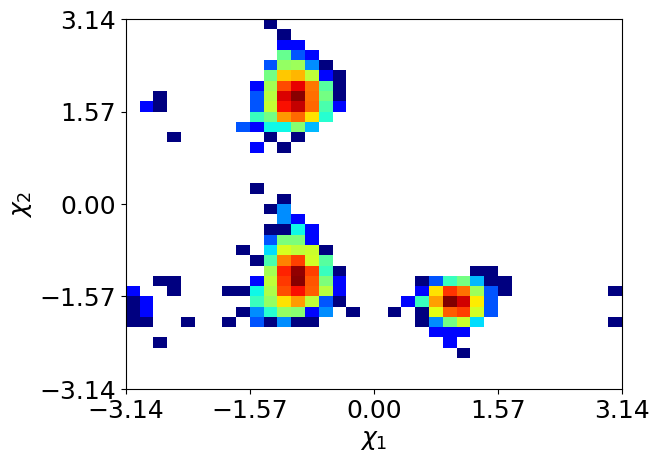

In [78]:
# Plot of chi1 v chi2 for Y253 
plot_chi(253)

In [87]:
# frames are 1024 and 80. 
chi1 = md.compute_chi1(trj)
print("indices for the tyrosine above x1", chi1[0][8])
print("Frame 1024 gives a chi1 of ", chi1[1][:,8][1024], "\n", "Frame 80 gives a chi1 of ", chi1[1][:,8][80])

indices for the tyrosine above x1 [170 172 174 177]
Frame 1024 gives a chi1 of  0.9384112 
 Frame 80 gives a chi1 of  -0.8926349


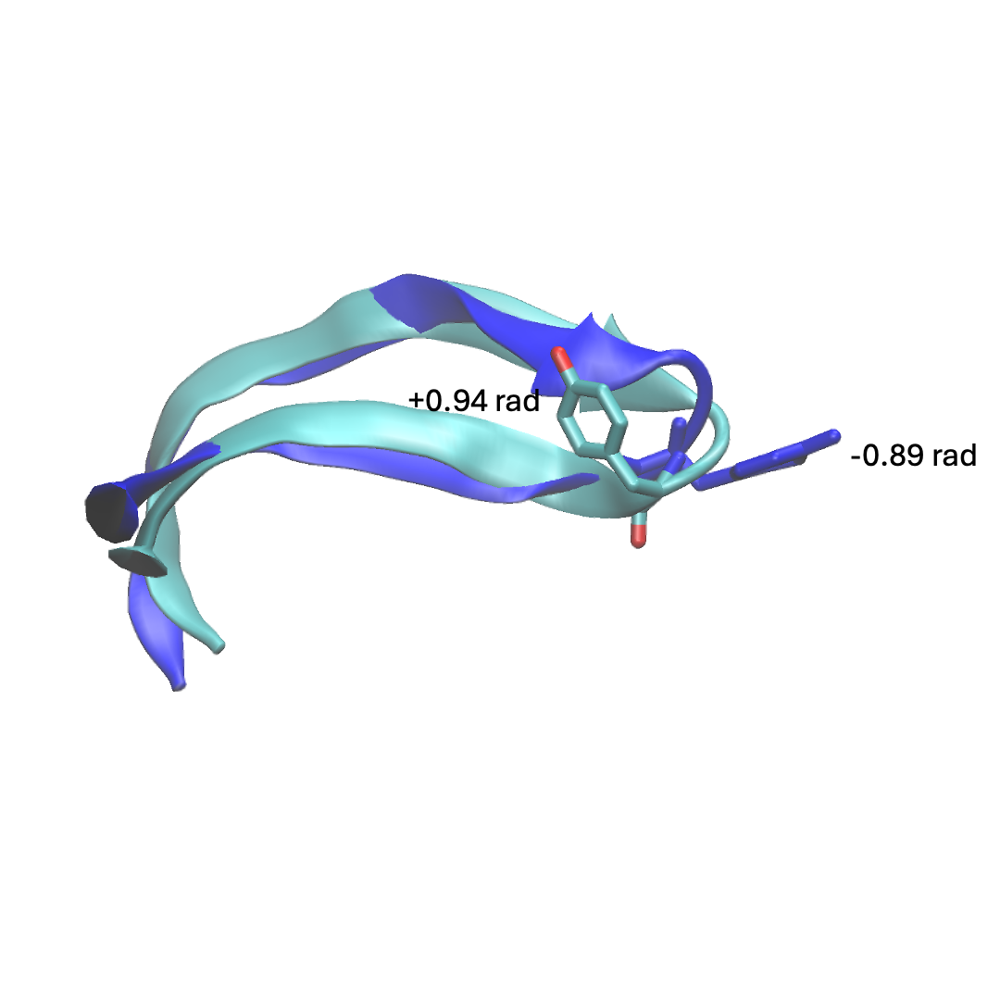

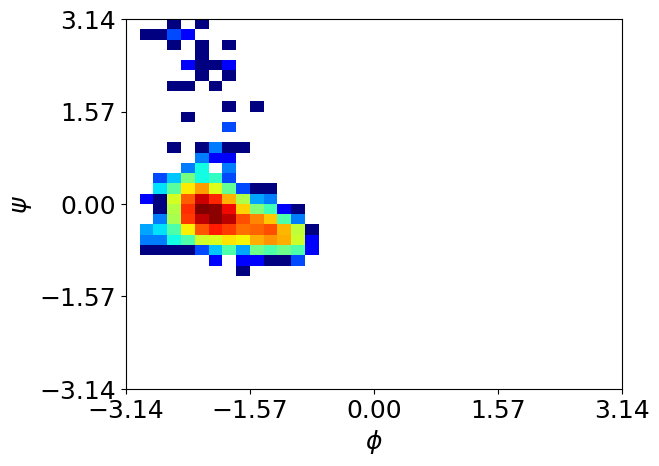

In [88]:
plot_phipsi(253)

***HOMEWORK Problem 4***

**Identify a residue that has 2 phi/psi free energy minima states and make representative snapshots to illustrate representative conformations (or a single snapshot with an overlay of two representative conformations).  Can you identify any other structural changes in the vicinity of that residue that favor the 2nd conformation.  Make a plot of the phi/psi histograms and add marking to the plot to indicate the phi/psi angles shown in your snapshot**


The residue that I am choosing with 2 phi/psi free energy minimum is TRP261. Below is the phipsi_FES. 

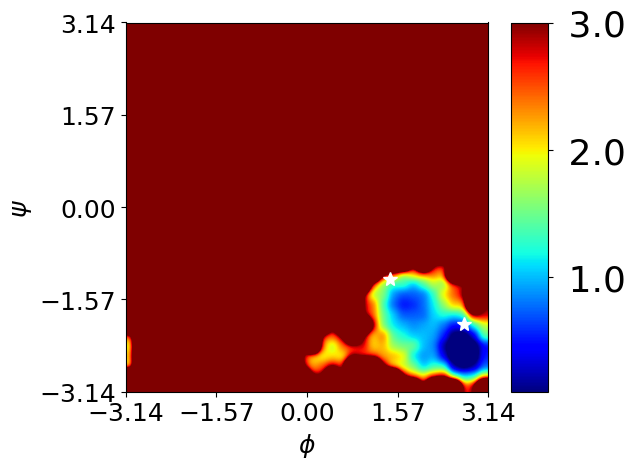

In [107]:
res = 261
free_energy,xedges,yedges=np.histogram2d(dihedral_dict['phi'][res],dihedral_dict['psi'][res],36,[[-3.14,3.14],[-3.14,3.14]],density=True,weights=None)
free_energy=np.log(np.flipud(free_energy)+.000001)
T=300                                                                                                  
kbT=T*0.008314/4.184 # kT in kcal/mol
dG=-(kbT)*free_energy #Convert to kcal/mol
im=plt.imshow(dG, interpolation='gaussian',extent=[yedges[0], yedges[-1], xedges[0], xedges[-1]],cmap='jet',aspect='auto')
cbar_ticks=[0,1,2,3]
cb = plt.colorbar(ticks=cbar_ticks, format=('% .1f'), aspect=10) # grab the Colorbar instance
imaxes = plt.gca()     
plt.plot(dihedral_dict['psi'][res][901], dihedral_dict['phi'][res][901], color="white", marker="*", markersize=10)
plt.plot( dihedral_dict['psi'][res][1448], dihedral_dict['phi'][res][1448], color="white", marker="*", markersize=10)                                                                                            
plt.xticks([-3.14,-3.14/2,0,3.14/2,3.14],fontsize=35)
plt.yticks([-3.14,-3.14/2,0,3.14/2,3.14],fontsize=35)
plt.xlabel('$\phi$', size=18)
plt.ylabel('$\psi$', size=18)
plt.tick_params(labelsize=18)
plt.axes(cb.ax)
plt.clim(vmin=0.1,vmax=3.0)
plt.yticks(size='26')
plt.tight_layout()
plt.show()

Frames 901 and 1448 show up in different parts of the ramachandran plot. Frame 901 shows up at the less populated basin, while 1448 the more populated. 

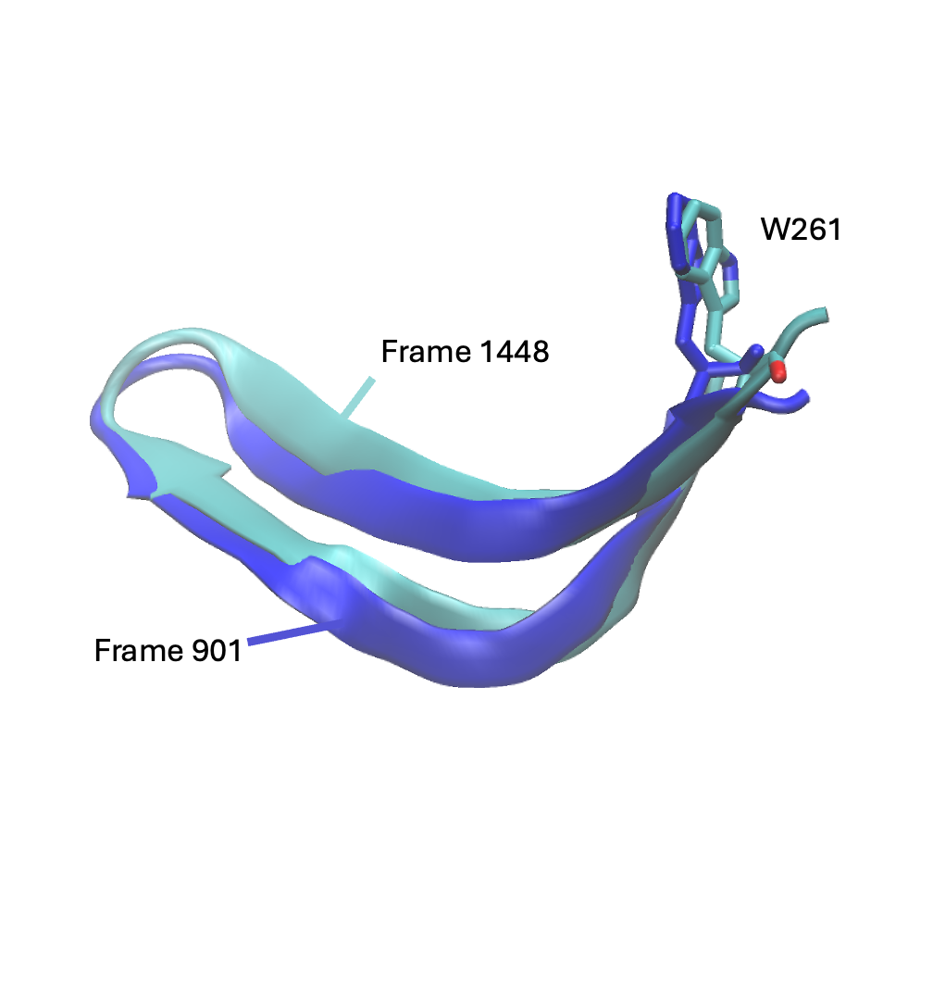

***Challenge Problem 2***

**Identify a residue with phi/psi basins that favor distinct rotamers and make a plot of chi distributions for different regions of the phi/psi basins**


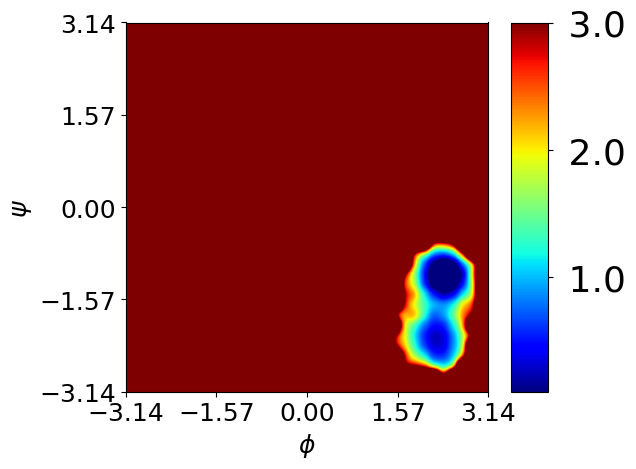

In [110]:
#Lets Make A Pretty Free Energy Plot 

def plot_phipsi_FES(res):
 free_energy,xedges,yedges=np.histogram2d(dihedral_dict['phi'][res],dihedral_dict['psi'][res],36,[[-3.14,3.14],[-3.14,3.14]],density=True,weights=None)
 free_energy=np.log(np.flipud(free_energy)+.000001)
 T=300                                                                                                  
 kbT=T*0.008314/4.184 # kT in kcal/mol
 dG=-(kbT)*free_energy #Convert to kcal/mol
 im=plt.imshow(dG, interpolation='gaussian',extent=[yedges[0], yedges[-1], xedges[0], xedges[-1]],cmap='jet',aspect='auto')
 cbar_ticks=[0,1,2,3]
 cb = plt.colorbar(ticks=cbar_ticks, format=('% .1f'), aspect=10) # grab the Colorbar instance
 imaxes = plt.gca()                                                                                                 
 plt.xticks([-3.14,-3.14/2,0,3.14/2,3.14],fontsize=35)
 plt.yticks([-3.14,-3.14/2,0,3.14/2,3.14],fontsize=35)
 plt.xlabel('$\phi$', size=18)
 plt.ylabel('$\psi$', size=18)
 plt.tick_params(labelsize=18)
 plt.axes(cb.ax)
 plt.clim(vmin=0.1,vmax=3.0)
 plt.yticks(size='26')
 plt.tight_layout()
 plt.show()
 return


plot_phipsi_FES(305)

In [159]:
# 
res = 305
phis = dihedral_dict['phi'][res]
chi1s = dihedral_dict["chi1"][res]

# basins 1 and 2 roughly
# b1_idx= np.where(phis > -1.5)[0]
# b2_idx = np.where(phis < -1.5) [0]

# chi1 range around pi 
chi1_around_pi = np.where((np.abs(chi1s) < np.pi) & (np.abs(chi1s) > np.pi -0.3))[0]
chi1_around_n_pi_o_2 = np.where((chi1s > -np.pi/4 -0.2) & (chi1s < -np.pi/4  +0.2))[0]
chi1_around_pi_o_2 = np.where((chi1s < np.pi/4 + 0.2) & (chi1s > np.pi/4 -0.2))[0]

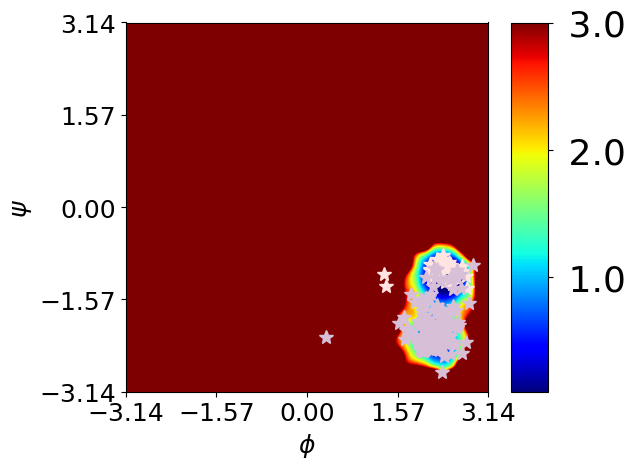

In [171]:
free_energy,xedges,yedges=np.histogram2d(dihedral_dict['phi'][res],dihedral_dict['psi'][res],36,[[-3.14,3.14],[-3.14,3.14]],density=True,weights=None)
free_energy=np.log(np.flipud(free_energy)+.000001)
T=300                                                                                                  
kbT=T*0.008314/4.184 # kT in kcal/mol
dG=-(kbT)*free_energy #Convert to kcal/mol
im=plt.imshow(dG, interpolation='gaussian',extent=[yedges[0], yedges[-1], xedges[0], xedges[-1]],cmap='jet',aspect='auto')
cbar_ticks=[0,1,2,3]
cb = plt.colorbar(ticks=cbar_ticks, format=('% .1f'), aspect=10) # grab the Colorbar instance
imaxes = plt.gca()     
plt.plot(dihedral_dict['psi'][res][chi1_around_pi_o_2], dihedral_dict['phi'][res][chi1_around_pi_o_2], color="mistyrose", marker="*", markersize=10, linestyle="None", alpha=1)
plt.plot( dihedral_dict['psi'][res][chi1_around_n_pi_o_2], dihedral_dict['phi'][res][chi1_around_n_pi_o_2], color="thistle", marker="*", markersize=10, linestyle="None", alpha=1)                                                                                            
plt.xticks([-3.14,-3.14/2,0,3.14/2,3.14],fontsize=35)
plt.yticks([-3.14,-3.14/2,0,3.14/2,3.14],fontsize=35)
plt.xlabel('$\phi$', size=18)
plt.ylabel('$\psi$', size=18)
plt.tick_params(labelsize=18)
plt.axes(cb.ax)
plt.clim(vmin=0.1,vmax=3.0)
plt.yticks(size='26')
plt.tight_layout()
plt.show()

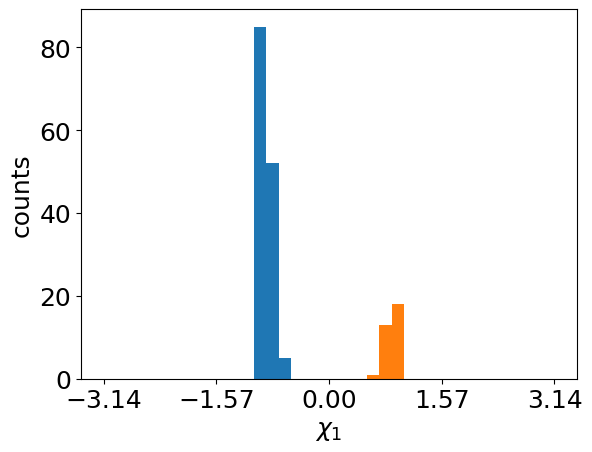

In [167]:
plt.hist(dihedral_dict['chi1'][res][chi1_around_n_pi_o_2],bins=36,range=[-3.14,3.14])   
plt.hist(dihedral_dict['chi1'][res][chi1_around_pi_o_2],bins=36,range=[-3.14,3.14])        

plt.xticks([-3.14,-3.14/2,0,3.14/2,3.14],fontsize=35)
plt.xlabel('$\chi_1$', size=18)
plt.ylabel('counts', size=18)
plt.tick_params(labelsize=18)
plt.show()


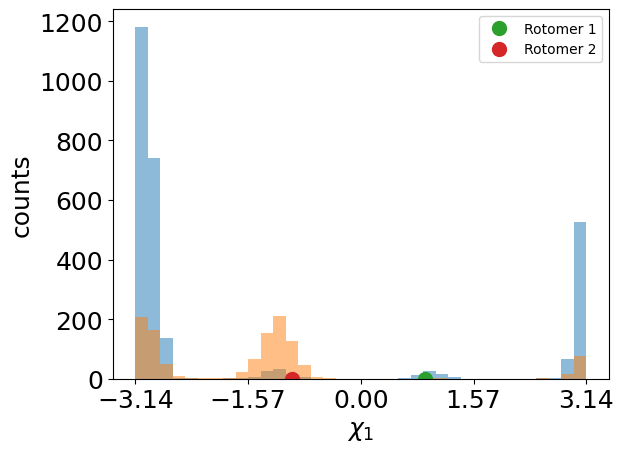

In [172]:
# worked on with grace 
# break up the two basins 
b1_idx= np.where(phis > -1.5)[0]
b2_idx = np.where(phis < -1.5)[0]

plt.hist(dihedral_dict['chi1'][res][b1_idx],bins=36,range=[-3.14,3.14], alpha=0.5)   
plt.hist(dihedral_dict['chi1'][res][b2_idx],bins=36,range=[-3.14,3.14], alpha=0.5)        
frames_to_highlight=[497, 11]
if frames_to_highlight:
            for idx, frame_num in enumerate(frames_to_highlight, start=1):
                chi1_value = dihedral_dict['chi1'][res][frame_num]
                label = f'Rotomer {idx}'
                plt.plot(chi1_value, 0, 'o', markersize=10, label=label)

plt.xticks([-3.14,-3.14/2,0,3.14/2,3.14],fontsize=35)
plt.xlabel('$\chi_1$', size=18)
plt.ylabel('counts', size=18)
plt.tick_params(labelsize=18)
plt.legend()
plt.show()


here are two highlighted frames with different rotamers that occupy essentially different basins for CYS 305 

Let's try this again with another residue:

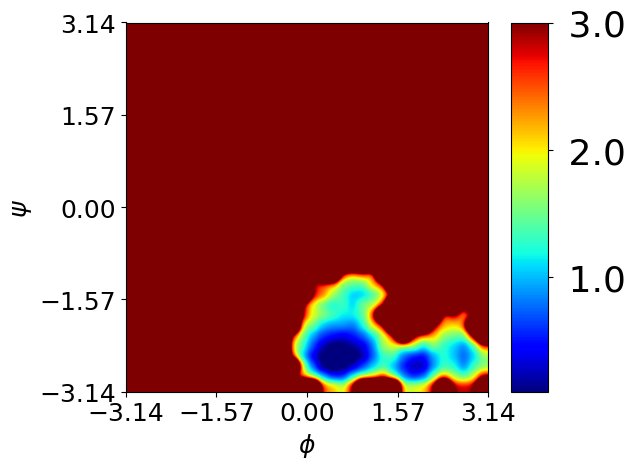

In [176]:
plot_phipsi_FES(363)

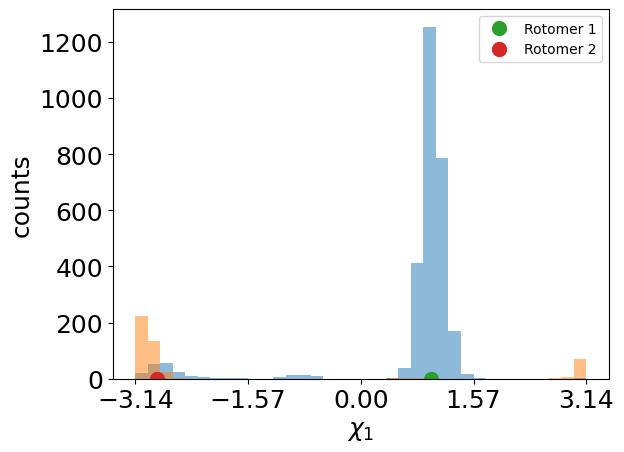

In [190]:
# break up the two basins 
res = 363
phis = dihedral_dict['phi'][res]
psis = dihedral_dict['psi'][res]
chi1s = dihedral_dict["chi1"][res]

# basins 1 and 2 roughly
b1_idx= np.where(psis <1.2)[0]
b2_idx = np.where((psis >1.5) & (psis < 2))[0]

plt.hist(dihedral_dict['chi1'][res][b1_idx],bins=36,range=[-3.14,3.14], alpha=0.5)   
plt.hist(dihedral_dict['chi1'][res][b2_idx],bins=36,range=[-3.14,3.14], alpha=0.5)        
frames_to_highlight=[63, 1811]
if frames_to_highlight:
            for idx, frame_num in enumerate(frames_to_highlight, start=1):
                chi1_value = dihedral_dict['chi1'][res][frame_num]
                label = f'Rotomer {idx}'
                plt.plot(chi1_value, 0, 'o', markersize=10, label=label)

plt.xticks([-3.14,-3.14/2,0,3.14/2,3.14],fontsize=35)
plt.xlabel('$\chi_1$', size=18)
plt.ylabel('counts', size=18)
plt.tick_params(labelsize=18)
plt.legend()
plt.show()

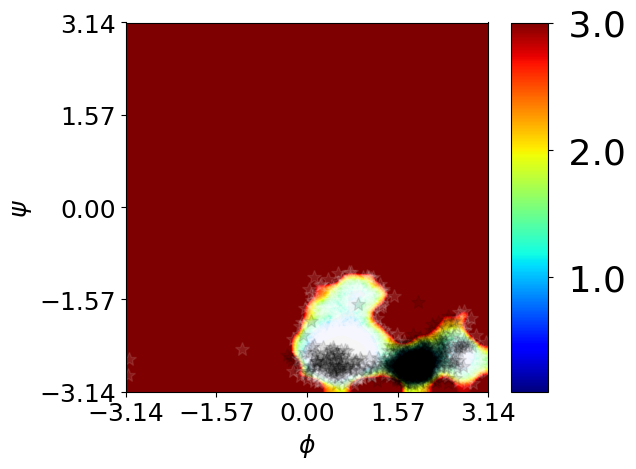

In [186]:
b1_chi = np.where((chi1s < 1.57 ) & (chi1s > 0))
b2_chi = np.where((np.abs(chi1s) < np.pi ) &  (np.abs(chi1s)> np.pi - 0.5))

# check where b1 and b2 are 
free_energy,xedges,yedges=np.histogram2d(dihedral_dict['phi'][res],dihedral_dict['psi'][res],36,[[-3.14,3.14],[-3.14,3.14]],density=True,weights=None)
free_energy=np.log(np.flipud(free_energy)+.000001)
T=300                                                                                                  
kbT=T*0.008314/4.184 # kT in kcal/mol
dG=-(kbT)*free_energy #Convert to kcal/mol
im=plt.imshow(dG, interpolation='gaussian',extent=[yedges[0], yedges[-1], xedges[0], xedges[-1]],cmap='jet',aspect='auto')
cbar_ticks=[0,1,2,3]
cb = plt.colorbar(ticks=cbar_ticks, format=('% .1f'), aspect=10) # grab the Colorbar instance
imaxes = plt.gca()     
plt.plot(dihedral_dict['psi'][res][b1_chi], dihedral_dict['phi'][res][b1_chi], color="white", marker="*", markersize=10, linestyle="None", alpha=0.1)
plt.plot( dihedral_dict['psi'][res][b2_chi], dihedral_dict['phi'][res][b2_chi], color="black", marker="*", markersize=10, linestyle="None", alpha=0.1)                                                                                            
plt.xticks([-3.14,-3.14/2,0,3.14/2,3.14],fontsize=35)
plt.yticks([-3.14,-3.14/2,0,3.14/2,3.14],fontsize=35)
plt.xlabel('$\phi$', size=18)
plt.ylabel('$\psi$', size=18)
plt.tick_params(labelsize=18)
plt.axes(cb.ax)
plt.clim(vmin=0.1,vmax=3.0)
plt.yticks(size='26')
plt.tight_layout()
plt.show()

The distribution up top shows two different chi1 values for ASP363. clearly, there is some overlap, but there are chi1s that favor one energy basin and another. 